# Deblending with Deep Preconditioners

## Author: M.Ravasi

This notebook presents an example of Deep Preconditioned inversion for seismic applications, more specifically to `deblending` seismic shot gathers. 

The overall procedure is divided into two phases:

- Representation learning: given patches of the recorded data (in common-shot domain, an AutoEncoder is trained to identify a strong latent representation of such a dataset;
- Physics-driven inversion: the trained Decoder is now used as a nonlinear preconditioner to the solution of the deblending in common-receiver domain.

We will be applying here the procedure to a synthetic dataset created from a simple layered geology with a syncline as shown below.

In [1]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

import warnings
warnings.filterwarnings('ignore')

import os
import numpy as np
import scipy as sp
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torch.nn.functional as F
import pylops

from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from scipy.sparse import csr_matrix, vstack
from scipy.signal import filtfilt, convolve
from scipy.linalg import lstsq, solve
from scipy.sparse.linalg import LinearOperator, cg, lsqr
from scipy import misc
from torchsummary import summary
from pytorch_lightning import seed_everything
from pytorch_lightning.callbacks.early_stopping import EarlyStopping as pl_EarlyStopping

from pylops.utils import dottest
from pylops.utils.wavelets import *
from pylops.utils.tapers import *
from pylops.basicoperators import *
from pylops.signalprocessing import *
from pylops.waveeqprocessing.oneway import PhaseShift, Deghosting
from pylops.optimization.sparsity  import *
from pylops_gpu import TorchOperator

from deepprecs.deblend import BlendingContinuous
from deepprecs.patching import patching, patch_scalings, patch2d_design
from deepprecs.subsampling import subsampling 
from deepprecs.aemodel import AutoencoderBase, AutoencoderRes, AutoencoderMultiRes
from deepprecs.train_pl import *
from deepprecs.invert import InvertAll

## Parameters

In [2]:
################# GLOBAL ####################
# Device
devicenum = 0
device = torch.device(f"cuda:{devicenum}" if torch.cuda.is_available() else "cpu")
print(device)
if 'cuda' in str(device):
    import cupy as cp

# Seed
seed_everything(5)

# Input filepath
inputfile = '../../data/syncline/input.npz'

# Model and figure directories
label = 'synclinedeblending'
outputmodels = f'../../models/{label}'
outputfigs = f'../../figures/{label}'

################# TRAINING ####################

# Patches
nspatch, ntpatch = 64, 64
nsjump, ntjump = 32, 32

# Experiment number and name
iexp = 11
expname = 'ResNet network with more filters 300enc - mse+ccc cost with learned weigths + mask'

# AE parameters
aetype = AutoencoderRes # AE type: AutoencoderBase, AutoencoderRes, AutoencoderMultiRes
nenc = 300 # Size of latent space
kernel_size = 5 # Size of filters kernels
nfilts = 32 # number of filters for conv layers in first level (doubles up going down)
nlayers = 2 # number of layers per level 
nlevels = 2 # number of levels
convbias = True # add bias to convolution layers 
downstride = 1 # stride of downsampling/pooling blocks (same will be used for upsampling blocks)
downmode = 'max' # type of pooling (avg or max)
upmode = 'upsample' # type of upsampling (convtransp, upsample or upsample1d)
bnormlast = True # add batch normalization to the last layer
act_fun = 'LeakyReLU' # activation function for all hidden layers
relu_enc = False # add ReLU activation to the linear layer of the encoder (this and tanh_enc cannot be both true)
tanh_enc = True # add TanH activation to the linear layer of the encoder
relu_dec = True # add ReLU activation to the linear layer of the decoder
tanh_final = False # add TanH activation to the last layer of the network - ensures the output is bounded between [-1, 1]

# Loss/optimizer
loss = 'mse_ccc' # loss: mse, weightmse, l1, ssim, peaerson, mse_pearson, l1_pearson, ccc, mse_ccc, l1_ccc
lossweights = None
betas = (0.5, 0.9) # betas of Adam optimizer
weight_decay = 1e-5 # weigth decay of Adam optimizer
learning_rate = 1e-4 # learning rate of Adam optimizer
adapt_learning = True # apply adaptive learning rate
lr_scheduler = 'OneCycle' # type of adaptive learning rate: OnPlateau, OneCycleLR
lr_factor = None # lr factor for OnPlateau
lr_thresh = None # lr thresh for OnPlateau
lr_patience = None # lr patience for OnPlateau
lr_max = 1e-3 # lr max for OneCycleLR
es_patience = 10 # early stopping patience
es_min_delta = 1e-3 # min difference to trigger early stopping

# Training
num_epochs = 40 # number of epochs
batch_size = 256 # batch size
noise_std = 0.0 # standard deviation noise to input
mask_perc = 0.2 # percentage of traces to mask

####### DEBLENDING #######
# Receiver index to be used for inversion
irec = 100

# Patching operator
nwin = (nspatch, ntpatch)
nop = (nspatch, ntpatch)
nover = (19, 8)

INFO: Global seed set to 5


cuda:0


## Load data

Let's start by importing the dataset we are going to use for this example

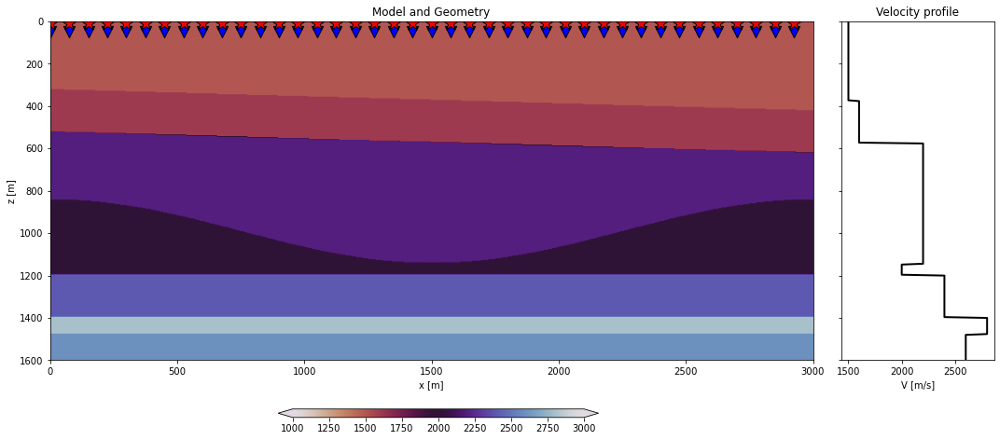

In [3]:
inputdata = np.load(inputfile)

# Receivers
r = inputdata['r'][:, :199]
nr = r.shape[1]
dr = r[0, 1] - r[0, 0]

# Sources
s = inputdata['s'][:, :199]
ns = s.shape[1]

# Model
rho = inputdata['rho']
vel = inputdata['vel']

# Axes
t = inputdata['t'][:904]
x, z = inputdata['x'], inputdata['z']
nt, dt = len(t), t[1]-t[0]
dx, dz = x[1] - x[0], z[1] - z[0]

# Load data
p = inputdata['p'][:199, :904, :199].transpose(0, 2, 1)
p /= p.max()

# Convolve with wavelet
fwav = 15
wav, _, wav_c = ricker(t[:201], fwav)
p = np.apply_along_axis(convolve, -1, p, wav, mode='full')
p = p[:, :, wav_c:][:, :, :nt]

# Visualize
fig, axs = plt.subplots(1, 2, figsize=(15, 6), sharey=True, gridspec_kw={'width_ratios': [5, 1]})
axins1 = inset_axes(axs[0],
                    width="70%",  # width = 50% of parent_bbox width
                    height="5%",  # height : 5%
                    bbox_to_anchor=(0.125, -0.63, .6, .5),
                    bbox_transform=axs[0].transAxes)
im = axs[0].imshow(vel, extent = (x[0], x[-1], z[-1], z[0]), vmin=1000, vmax=3000, cmap='twilight_r')
axs[0].scatter(r[0, ::5],  r[1, ::5], marker='v', s=150, c='b', edgecolors='k')
axs[0].scatter(s[0, ::5], s[1, ::5], marker='*', s=250, c='r', edgecolors='k')
axs[0].axis('tight')
axs[0].set_xlabel('x [m]')
axs[0].set_ylabel('z [m]')
axs[0].set_title('Model and Geometry')
axs[0].set_xlim(x[0], x[-1])
axs[0].set_ylim(z[-1], z[0])
fig.colorbar(im, cax=axins1, orientation='horizontal', extend="both", fraction=0.046, pad=0.12) 
axs[1].plot(vel[:, len(x)//2], z, 'k', lw=2)
axs[1].set_title('Velocity profile')
axs[1].set_xlabel('V [m/s]')
plt.tight_layout()
plt.savefig(os.path.join(outputfigs, f'{label}_model.eps'), dpi=100, bbox_inches='tight')

## Deblending problem

Before we start our training process, let's define the blending operator to be used in the subsequent inversion process. 

We will provide our network with such an operator so that later we can apply it directly to the output of its decoder

Dot test passed, v^H(Opu)=2629.51806640625 - u^H(Op^Hv)=2629.659912109375


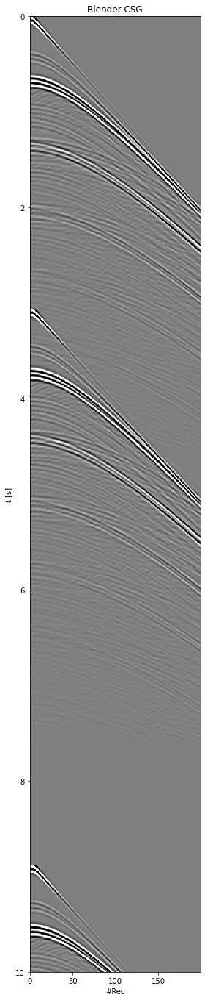

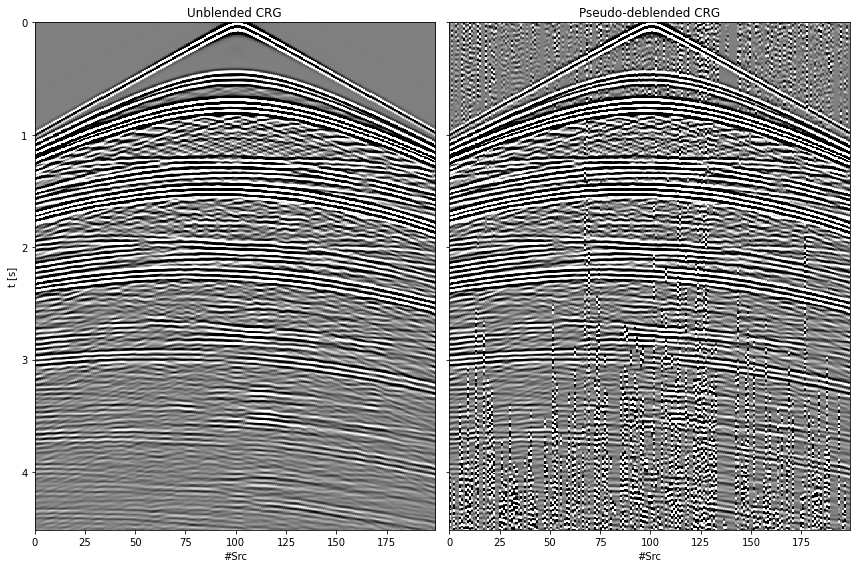

In [4]:
# Blending operator
overlap = 0.25
ignition_times = np.random.normal(0, 1., ns)
ignition_times += (1-overlap) * nt * dt
ignition_times[0] = 0.
#print('ignition_times', ignition_times)

# Blending
Bop = BlendingContinuous(nt, nr, ns, dt, np.cumsum(ignition_times), dtype="complex64")
dottest(Bop, verb=True, tol=1e-2)
pblended = Bop * p.ravel()
ppseudo = Bop.H * pblended

pblended = pblended.reshape(Bop.nr, Bop.nttot)
ppseudo = ppseudo.reshape(Bop.ns, Bop.nr, Bop.nt)

# Visualize
fig, ax = plt.subplots(1, 1, figsize=(4, 19))
ax.imshow(pblended.T, cmap="gray",
          vmin=-.1, vmax=.1,
          extent=(0, nr, Bop.nttot*dt, 0),
          interpolation="none")
ax.set_title("Blender CSG")
ax.set_xlabel("#Rec")
ax.set_ylabel("t [s]")
ax.axis("tight")
ax.set_ylim(10, 0)
plt.tight_layout()

fig, axs = plt.subplots(1, 2, sharey=True, figsize=(12, 8))
axs[0].imshow(p[:, irec].T, cmap="gray",
              vmin=-.01, vmax=.01,
              extent=(0, ns, t[-1], 0),
              interpolation="none")
axs[0].set_title("Unblended CRG")
axs[0].set_xlabel("#Src")
axs[0].set_ylabel("t [s]")
axs[0].axis("tight")
axs[1].imshow(ppseudo[:, irec].T, cmap="gray",
              vmin=-.01, vmax=.01,
              extent=(0, ns, t[-1], 0),
              interpolation="none")
axs[1].set_title("Pseudo-deblended CRG")
axs[1].set_xlabel("#Src")
axs[1].axis("tight")
plt.tight_layout();

True

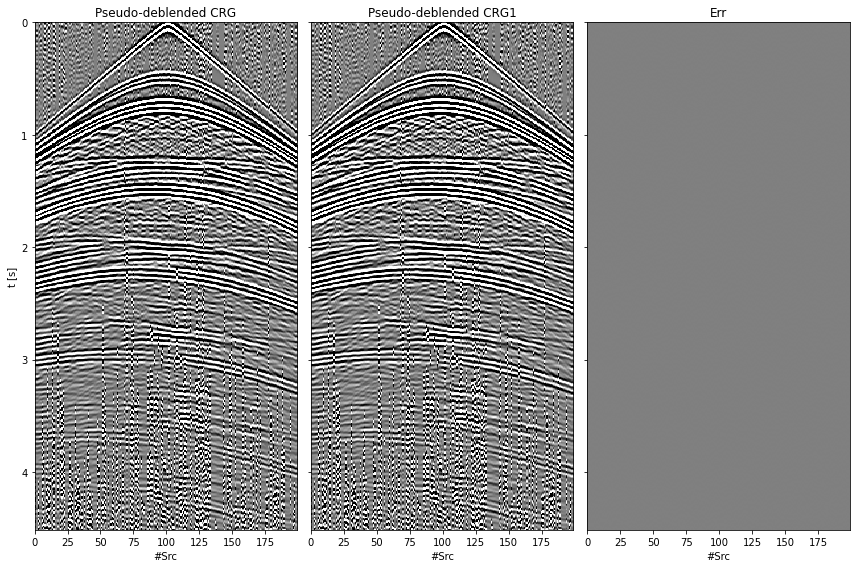

In [5]:
# Create data to deblend (single receiver-gather)
pblend = pblended[irec] 

# Convert data to torch
pblend_torch = torch.from_numpy(pblend.astype(np.float32)).to(device)

# Create blending operator for single receiver
B1op = BlendingContinuous(nt, 1, ns, dt, np.cumsum(ignition_times), dtype="complex128")

ppseudo1 = B1op.H * pblend[np.newaxis].ravel()
ppseudo1 = ppseudo1.reshape(ns, nt)

fig, axs = plt.subplots(1, 3, sharey=True, figsize=(12, 8))
axs[0].imshow(ppseudo[:, irec].T, cmap="gray",
              vmin=-.01, vmax=.01,
              extent=(0, ns, t[-1], 0),
              interpolation="none")
axs[0].set_title("Pseudo-deblended CRG")
axs[0].set_xlabel("#Src")
axs[0].set_ylabel("t [s]")
axs[0].axis("tight")
axs[1].imshow(ppseudo1.T, cmap="gray",
              vmin=-.01, vmax=.01,
              extent=(0, ns, t[-1], 0),
              interpolation="none")
axs[1].set_title("Pseudo-deblended CRG1")
axs[1].set_xlabel("#Src")
axs[1].axis("tight")
axs[2].imshow(ppseudo[:, irec].T - ppseudo1.T, cmap="gray",
              vmin=-.0001, vmax=.0001,
              extent=(0, ns, t[-1], 0),
              interpolation="none")
axs[2].set_title("Err")
axs[2].set_xlabel("#Src")
axs[2].axis("tight")
plt.tight_layout();

np.allclose(ppseudo[:, irec].T, ppseudo1.T)

  960 1024]
  960 1024]


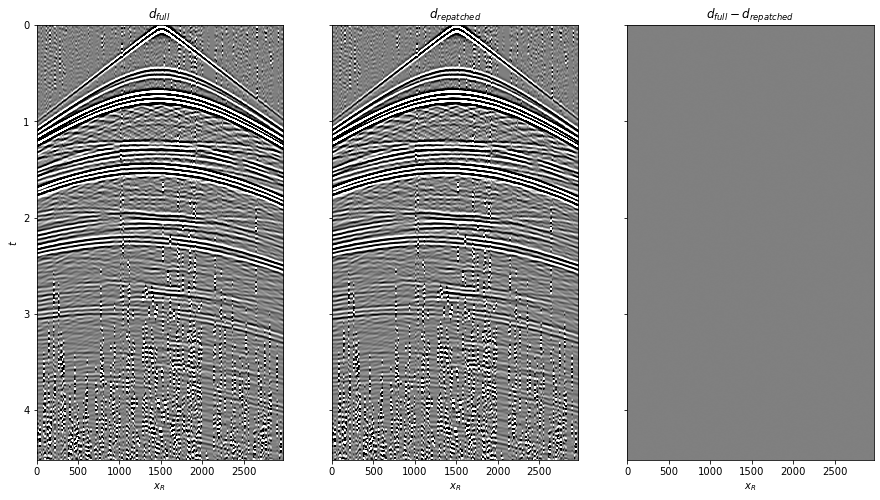

In [6]:
# Patch operator
dimsd = (ns, nt)
npatches = patch2d_design(dimsd, (nspatch, ntpatch), nover, nop)[0]
dims = (npatches[0]*nspatch, npatches[1]*ntpatch)

Op = Identity(nspatch*ntpatch, dtype='float32')
Pop = Patch2D(Op, dims, dimsd, nwin, nover, nop,
              tapertype=None, design=True)
Pop1 = Patch2D(Op.H, dims, dimsd, nwin, nover, nop,
              tapertype='cosine', design=False)
Pop1_torch = TorchOperator(Pop1, pylops=True, device=device)

# Create patches and revert back
ppseudo_patches = Pop.H * ppseudo1.ravel()
ppseudo_patches = ppseudo_patches.reshape(dims)
ppseudo_repatched = Pop1 * ppseudo_patches.ravel()
ppseudo_repatched = ppseudo_repatched.reshape(dimsd)

# Visualize
clip = 0.01
fig, axs = plt.subplots(1, 3, sharey=True, figsize=(15, 8))
axs[0].imshow(ppseudo1.T, cmap='gray',  
              vmin=-clip*np.abs(ppseudo1).max(), vmax=clip*np.abs(ppseudo1).max(), 
              extent=(r[0,0], r[0,-1], t[-1], t[0]))
axs[0].set_title(r'$d_{full}$')
axs[0].set_xlabel(r'$x_R$')
axs[0].set_ylabel(r'$t$')
axs[0].axis('tight')
axs[1].imshow(ppseudo_repatched.T, cmap='gray', 
              vmin=-clip*np.abs(ppseudo1).max(), vmax=clip*np.abs(ppseudo1).max(),
              extent=(r[0,0], r[0,-1], t[-1], t[0]))
axs[1].set_title(r'$d_{repatched}$')
axs[1].set_xlabel(r'$x_R$')
axs[1].axis('tight')
axs[1].set_ylim(2, 0)
axs[2].imshow(ppseudo1.T-ppseudo_repatched.T, cmap='gray', 
              vmin=-clip*np.abs(ppseudo1).max(), vmax=clip*np.abs(ppseudo1).max(),
              extent=(r[0,0], r[0,-1], t[-1], t[0]))
axs[2].set_title(r'$d_{full}-d_{repatched}$')
axs[2].set_xlabel(r'$x_R$')
axs[2].axis('tight');

Scalings tensor([0.0427, 0.0594, 0.1922, 0.2053, 0.2099, 0.0899, 0.0862, 0.0447, 0.0493,
        0.1854, 0.2042, 0.1913, 0.1926, 0.1975, 0.1948, 0.2146, 1.6541, 0.2291,
        0.2269, 0.2069, 0.2120, 1.3888, 1.3888, 0.5187, 0.5187, 0.7331, 1.2256,
        0.4582, 1.5780, 1.5572, 1.6483, 1.6483, 1.6541, 0.0996, 0.2316, 0.2133,
        0.2837, 1.3888, 1.3888, 0.5187, 0.5187, 0.7331, 1.2256, 0.4582, 1.5780,
        1.5572, 1.6483, 1.6483, 0.1706, 0.0685, 0.1814, 0.1980, 0.1946, 0.0967,
        0.0866, 0.1763, 0.0711, 0.1788, 0.1878, 0.1977, 0.1903, 0.1835, 0.1806,
        0.1971], device='cuda:0')


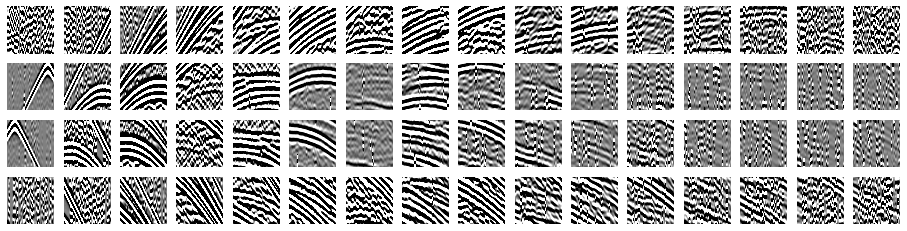

In [7]:
# Find scalings
scalings = patch_scalings(ppseudo1, Pop, npatches, npatch=(nspatch, ntpatch), 
                          plotflag=True, clip=clip, device=device)

In [8]:
# Overall operator
B1op_torch = TorchOperator(B1op, pylops=True, device=device);

## Dataset generation

Let's now generate the training dataset by patching up the available seismic data

Nsamples: 20743
Nsamples (after augumentation): 20743


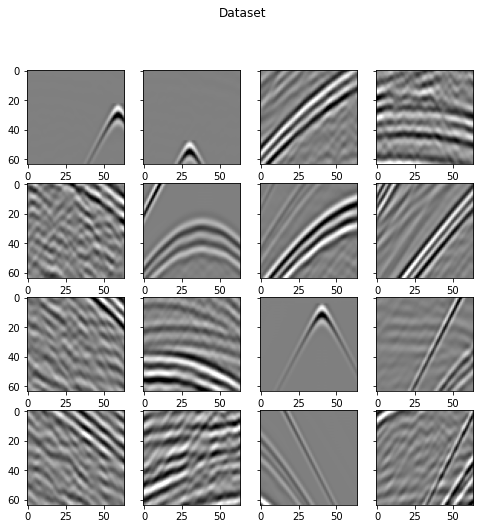

In [9]:
# Create patches
xs = patching(pblended[:, np.newaxis, :], s, r, dt, 
              npatch=(nspatch, ntpatch), njump=(nsjump, ntjump), window=False, 
              augumentdirect=False)

# Visualize
cmax = 0.8
nviz = 4
np.random.seed(5)
ivizs = np.random.permutation(np.arange(len(xs)))[:nviz**2]
fig, axs = plt.subplots(nviz, nviz, sharey=True, figsize=(8, 8))
axs = axs.ravel()
fig.suptitle('Dataset', y=0.99)
for i, iviz in enumerate(ivizs):
    axs[i].imshow(xs[iviz].T, cmap='gray', vmin=-cmax, vmax=cmax)
    axs[i].axis('tight')

## Training

Working with Experiment 11 - ResNet network with more filters 300enc - mse+ccc cost with learned weigths + mask


INFO: GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO: IPU available: False, using: 0 IPUs
INFO: HPU available: False, using: 0 HPUs
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]
INFO: 
  | Name    | Type           | Params
-------------------------------------------
0 | network | AutoencoderRes | 15.9 M
-------------------------------------------
15.9 M    Trainable params
0         Non-trainable params
15.9 M    Total params
63.521    Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

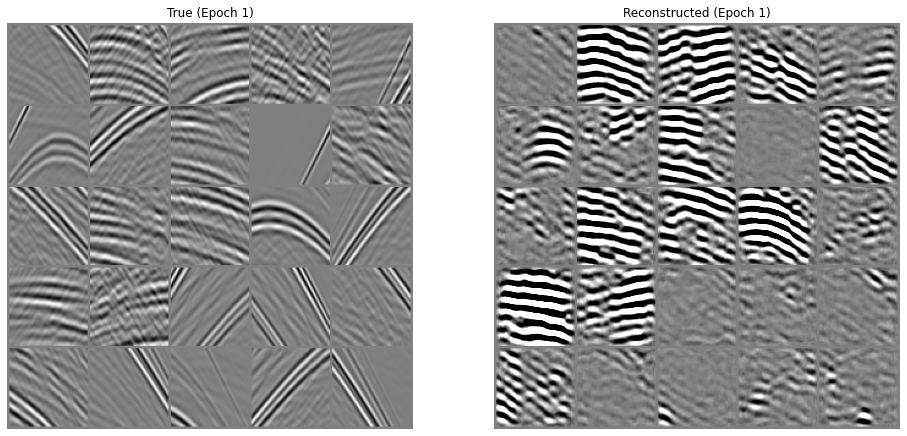

Validation: 0it [00:00, ?it/s]

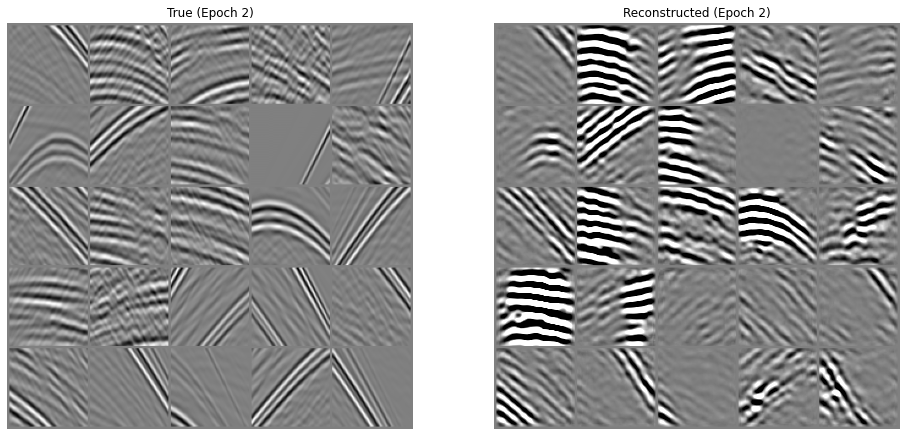

Validation: 0it [00:00, ?it/s]

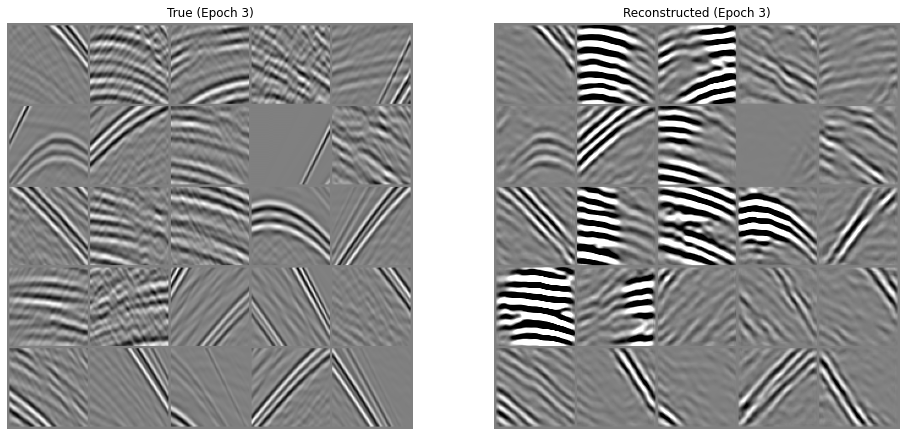

Validation: 0it [00:00, ?it/s]

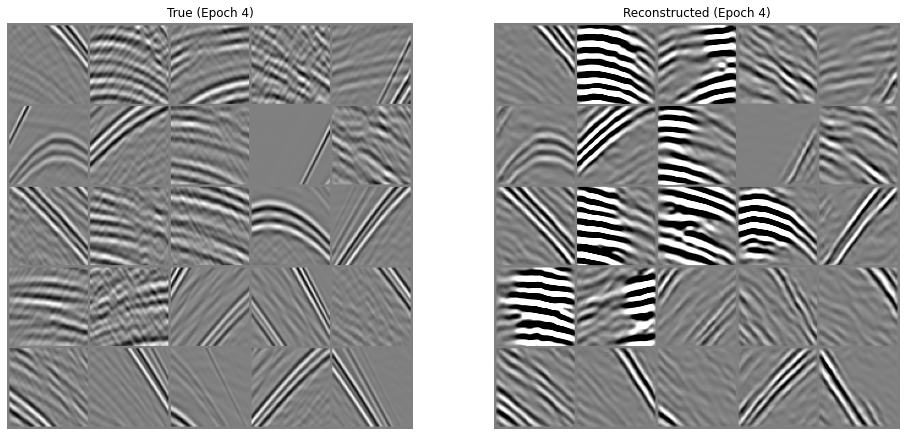

Validation: 0it [00:00, ?it/s]

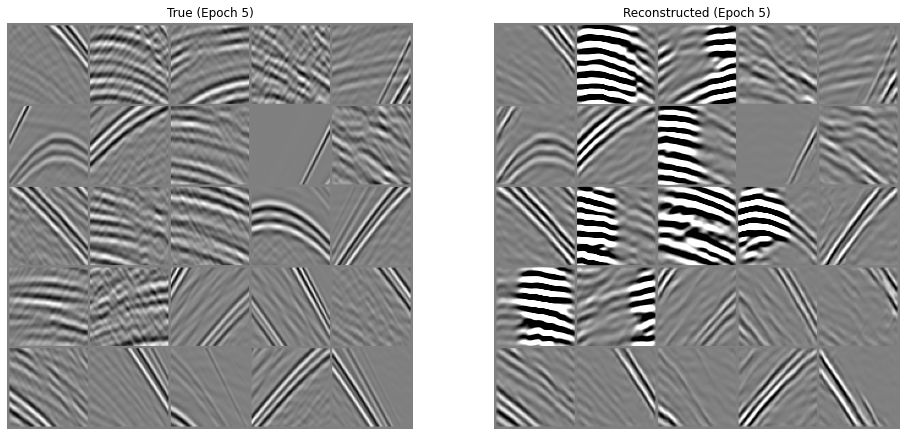

Validation: 0it [00:00, ?it/s]

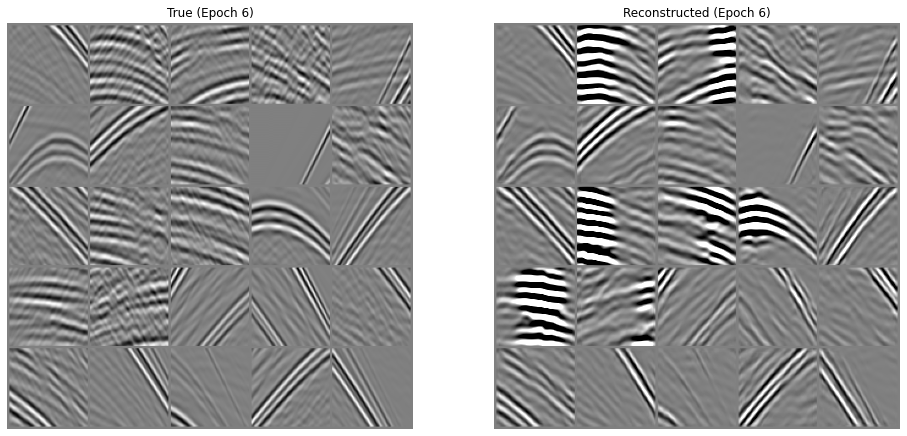

Validation: 0it [00:00, ?it/s]

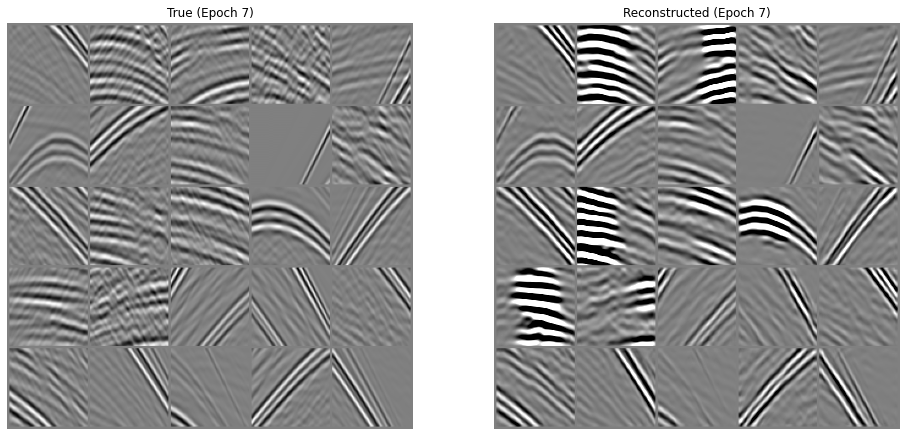

Validation: 0it [00:00, ?it/s]

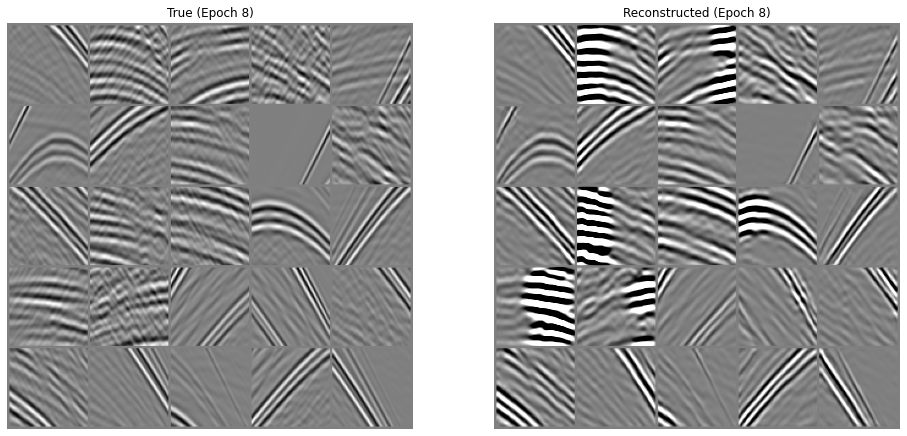

Validation: 0it [00:00, ?it/s]

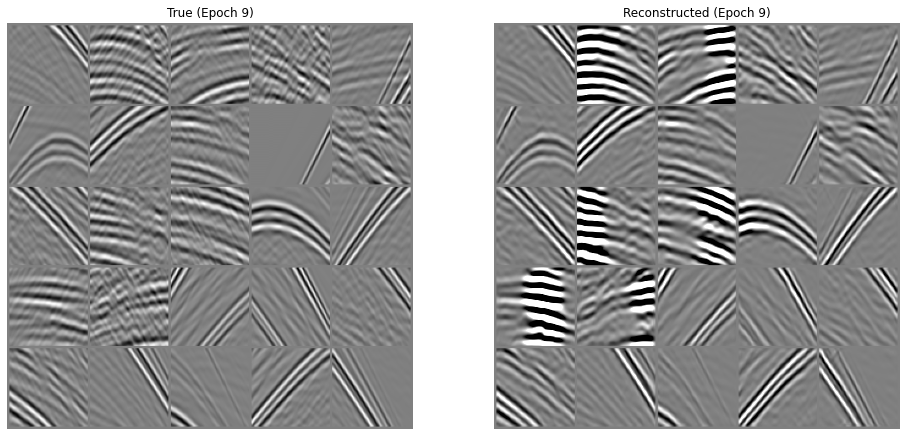

Validation: 0it [00:00, ?it/s]

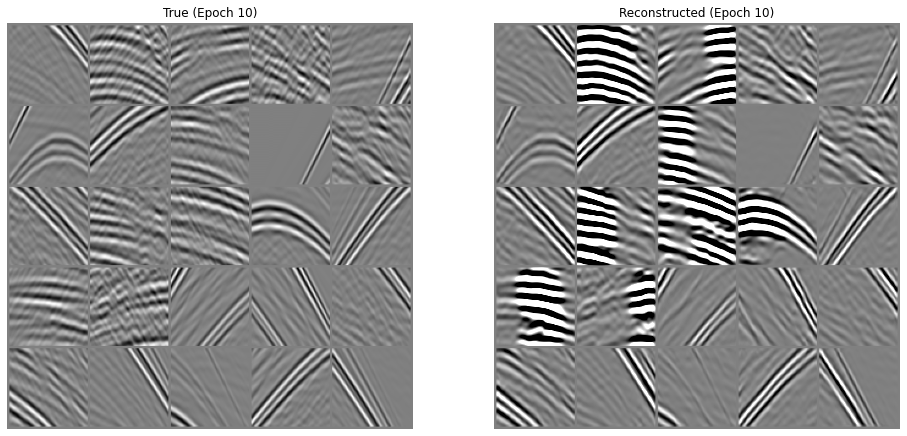

Validation: 0it [00:00, ?it/s]

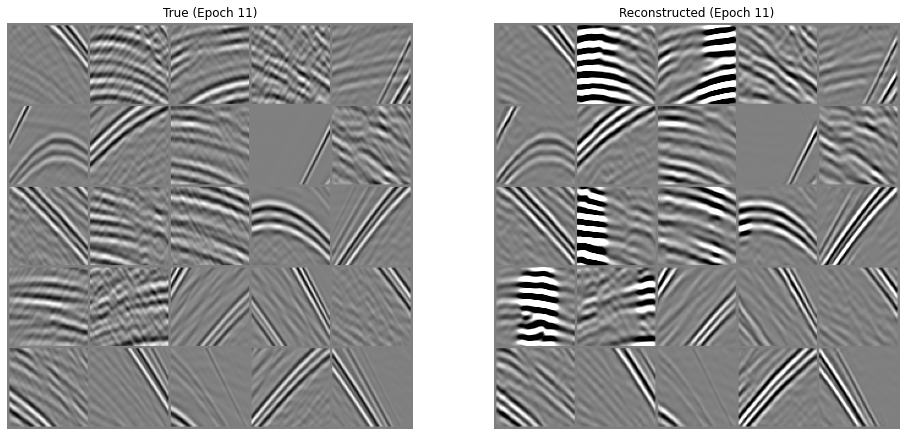

Validation: 0it [00:00, ?it/s]

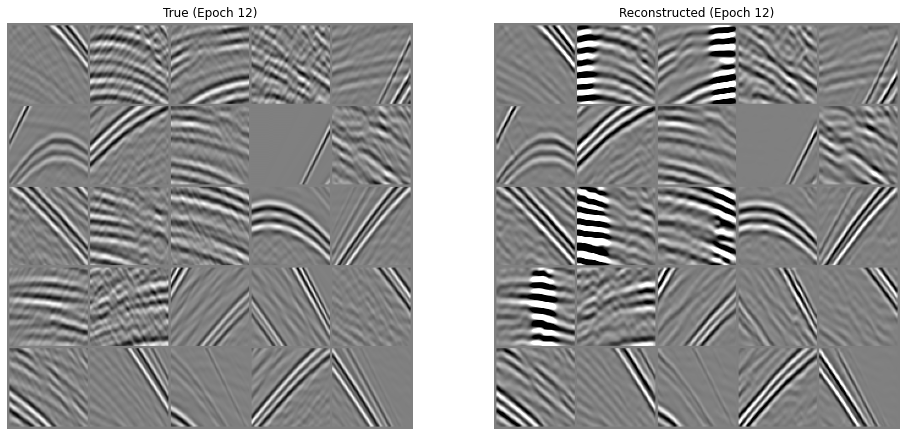

Validation: 0it [00:00, ?it/s]

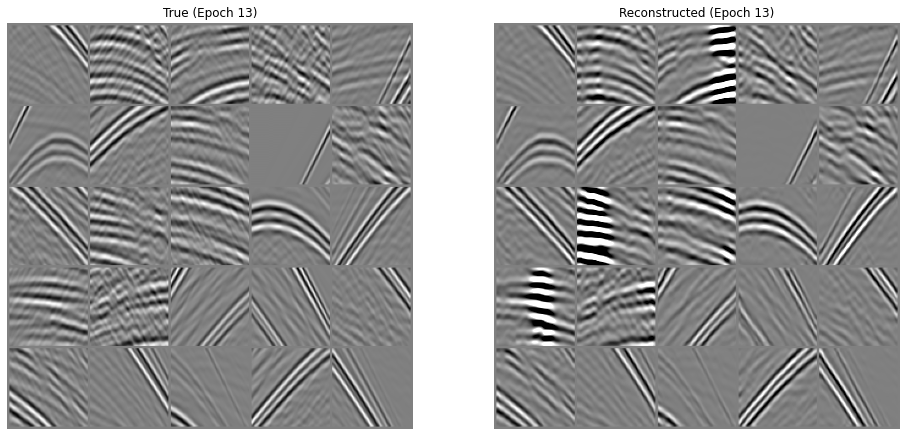

Validation: 0it [00:00, ?it/s]

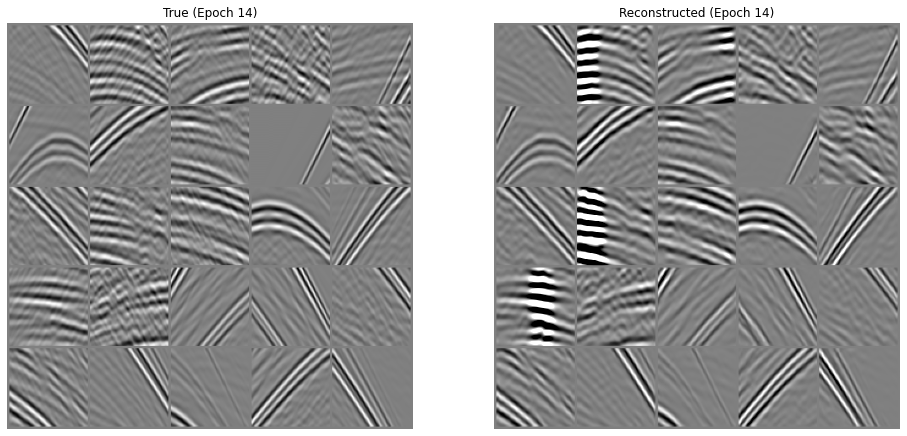

Validation: 0it [00:00, ?it/s]

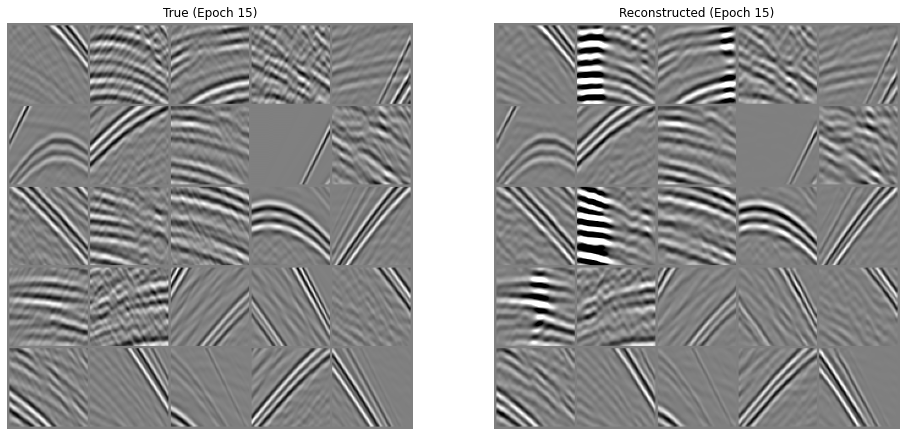

Validation: 0it [00:00, ?it/s]

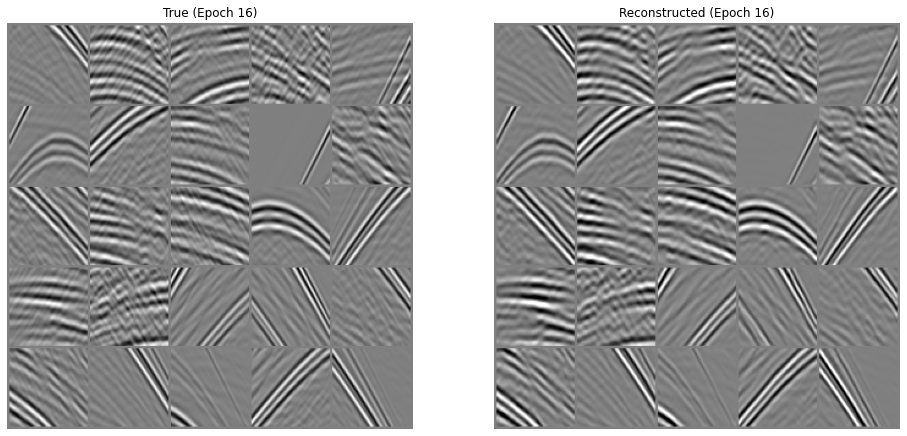

Validation: 0it [00:00, ?it/s]

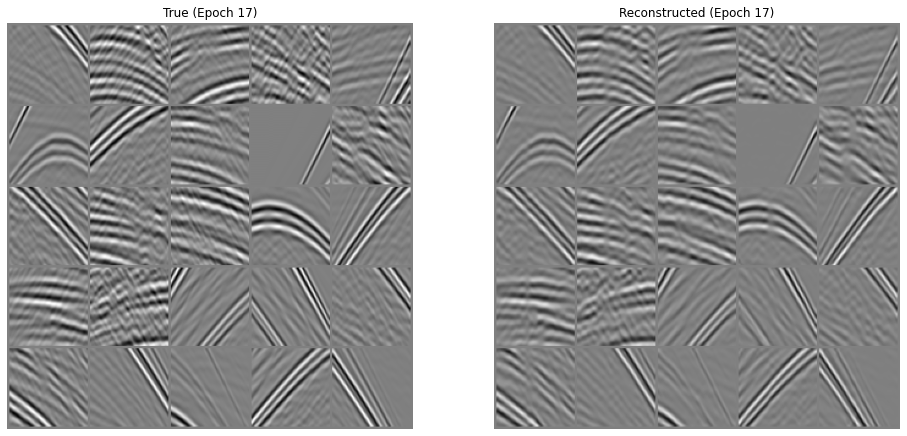

Validation: 0it [00:00, ?it/s]

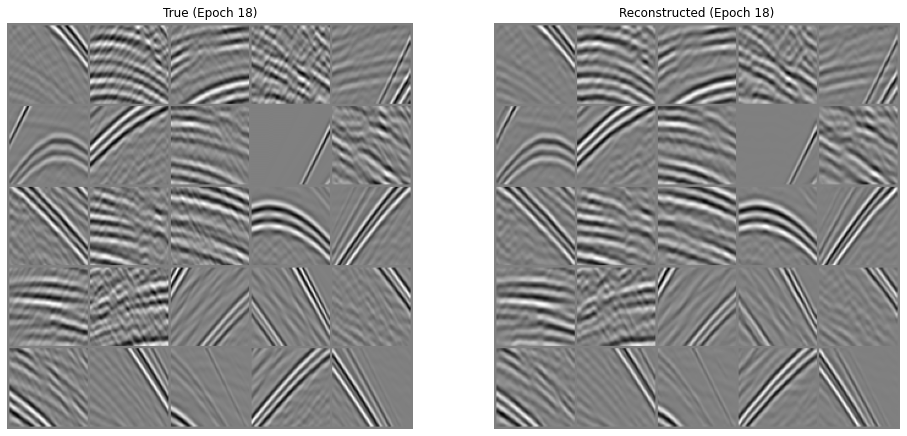

Validation: 0it [00:00, ?it/s]

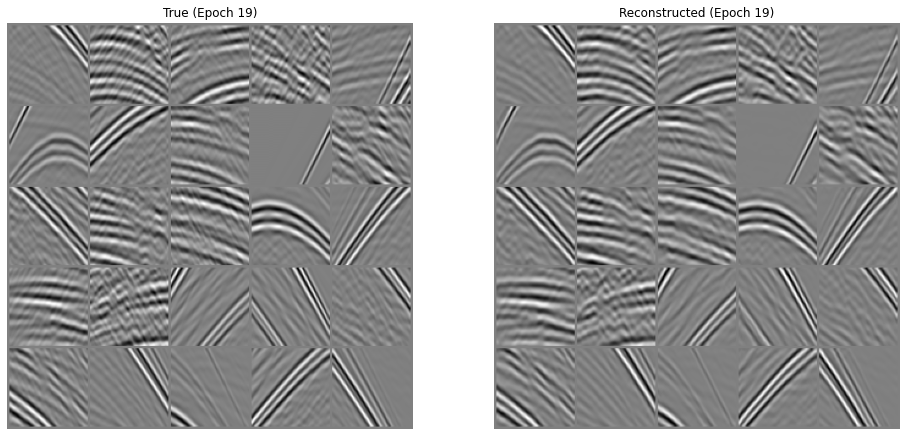

Validation: 0it [00:00, ?it/s]

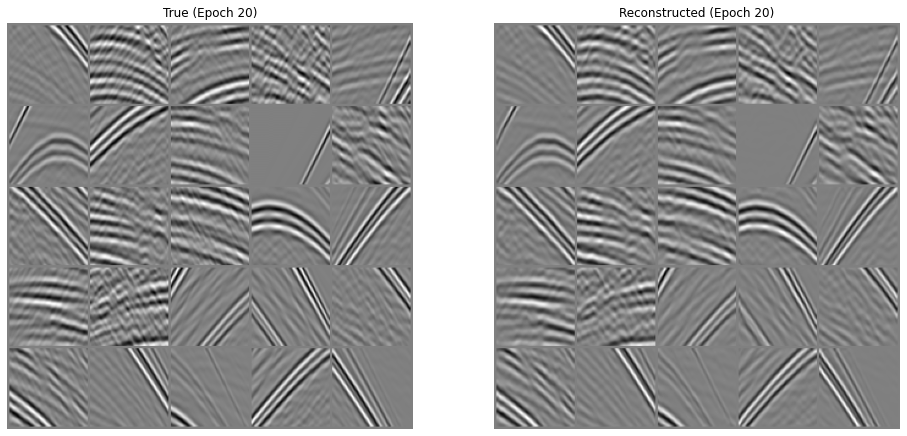

Validation: 0it [00:00, ?it/s]

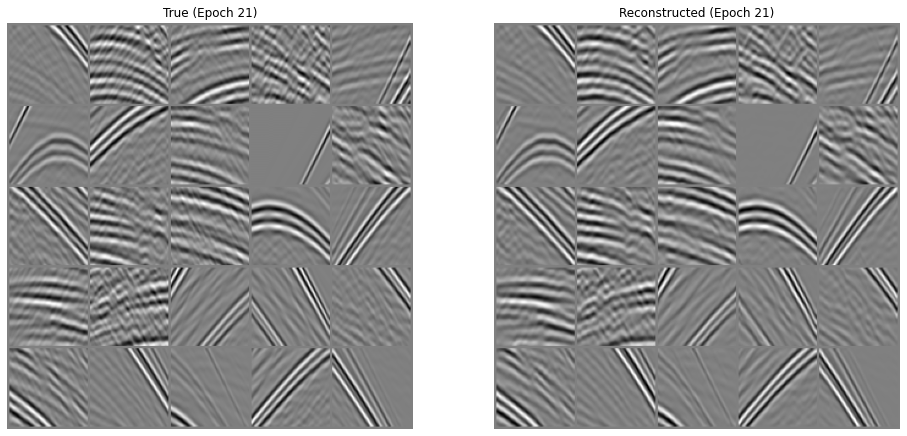

Validation: 0it [00:00, ?it/s]

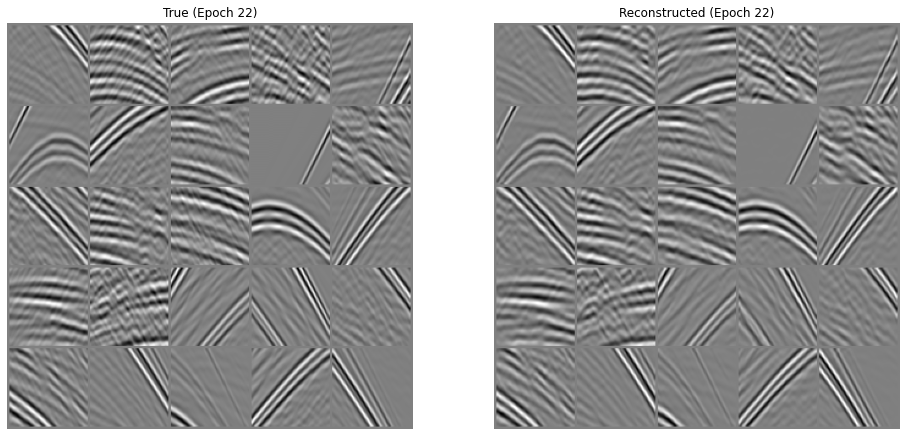

Validation: 0it [00:00, ?it/s]

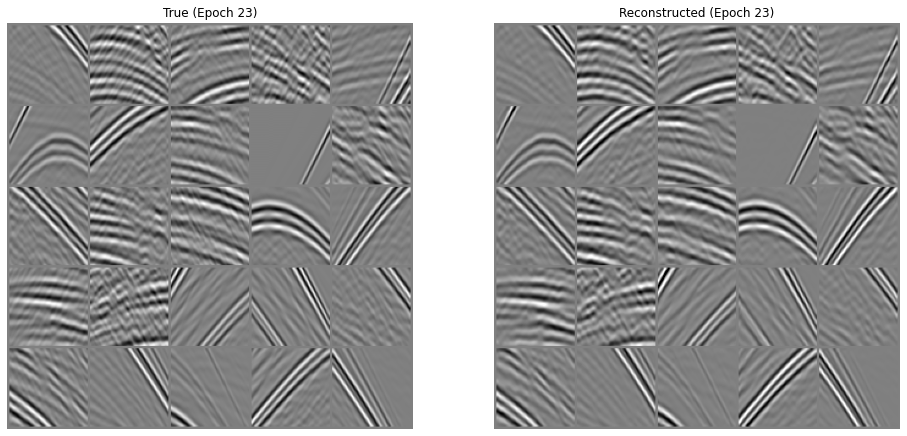

Validation: 0it [00:00, ?it/s]

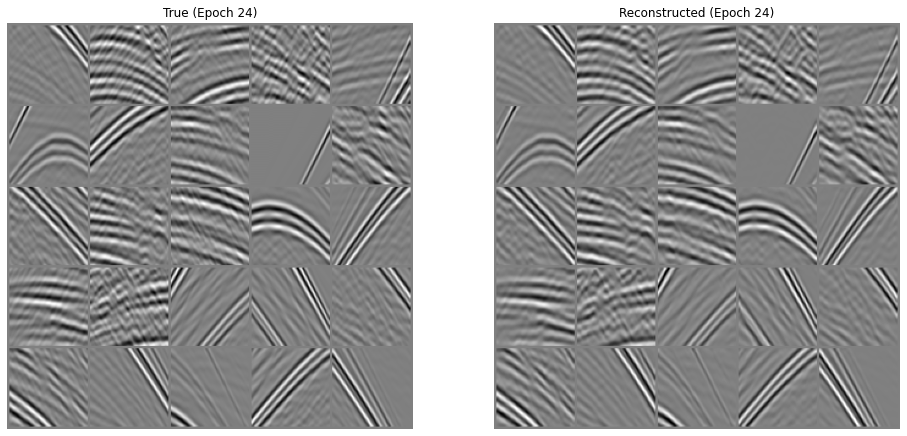

Validation: 0it [00:00, ?it/s]

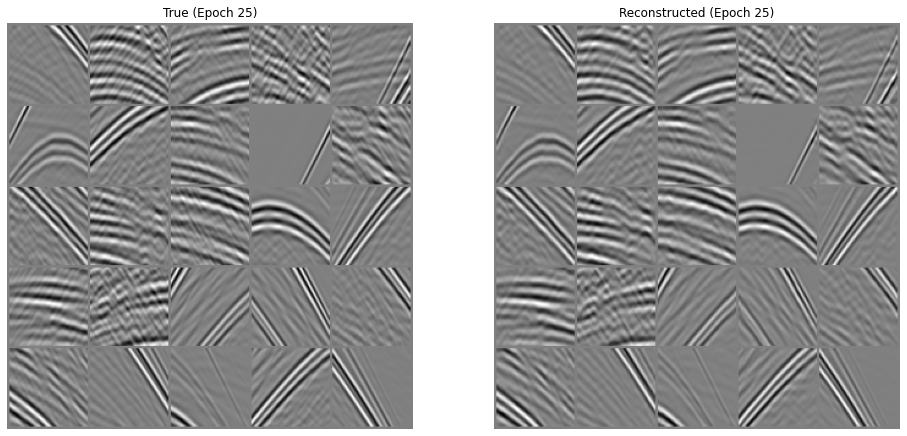

Validation: 0it [00:00, ?it/s]

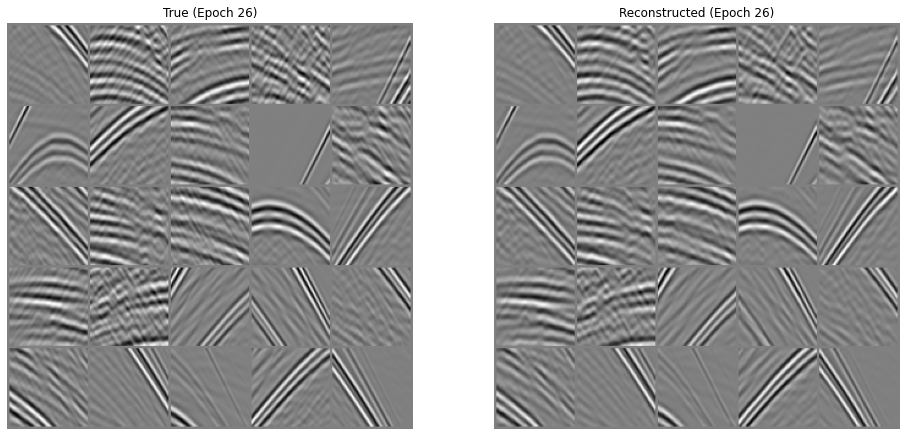

Validation: 0it [00:00, ?it/s]

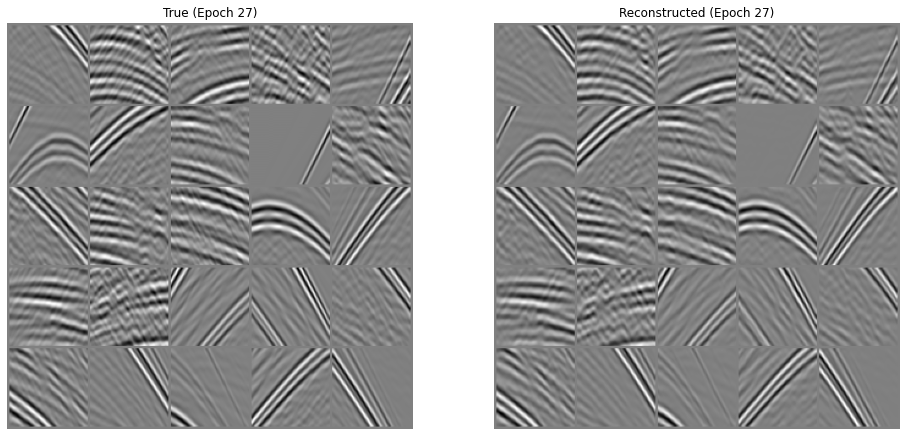

Validation: 0it [00:00, ?it/s]

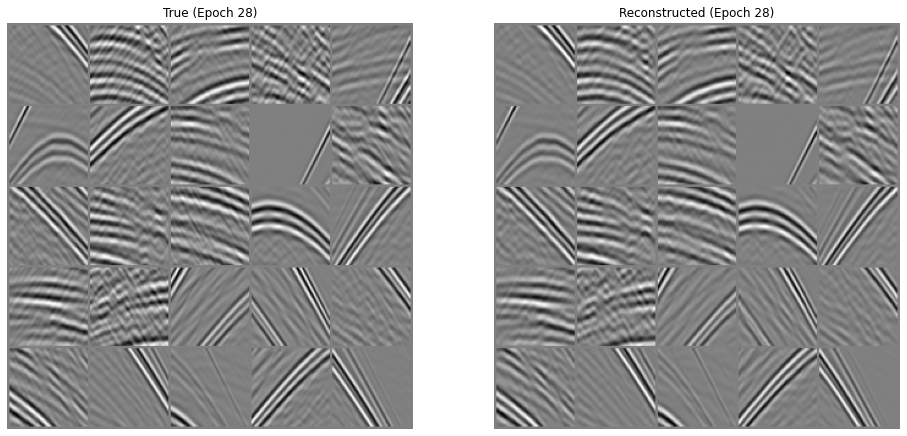

Validation: 0it [00:00, ?it/s]

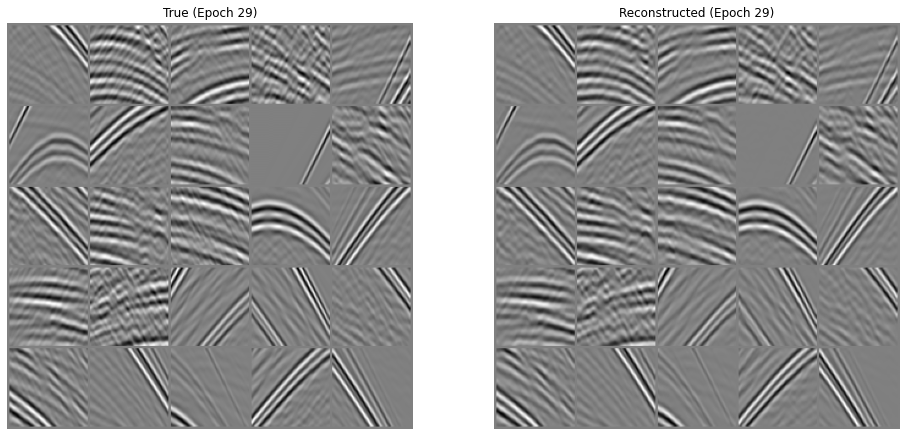

Validation: 0it [00:00, ?it/s]

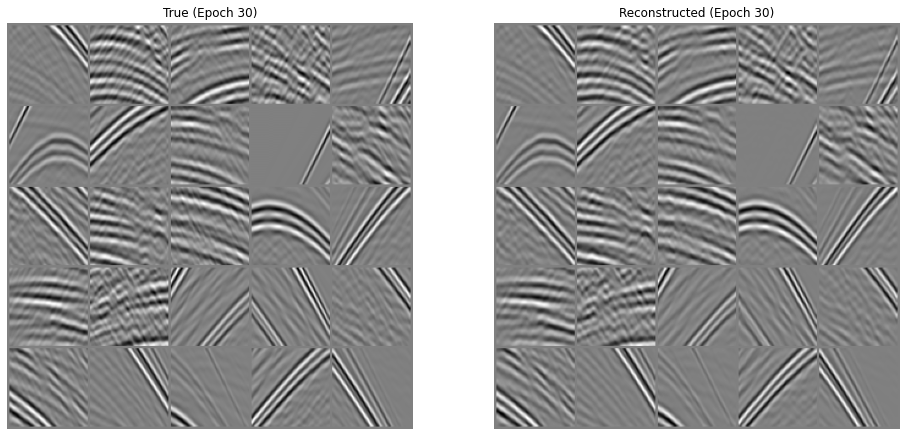

Validation: 0it [00:00, ?it/s]

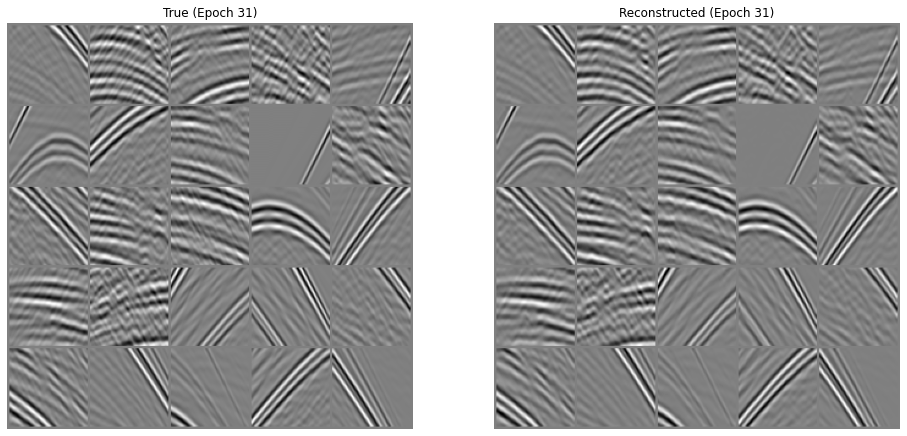

Validation: 0it [00:00, ?it/s]

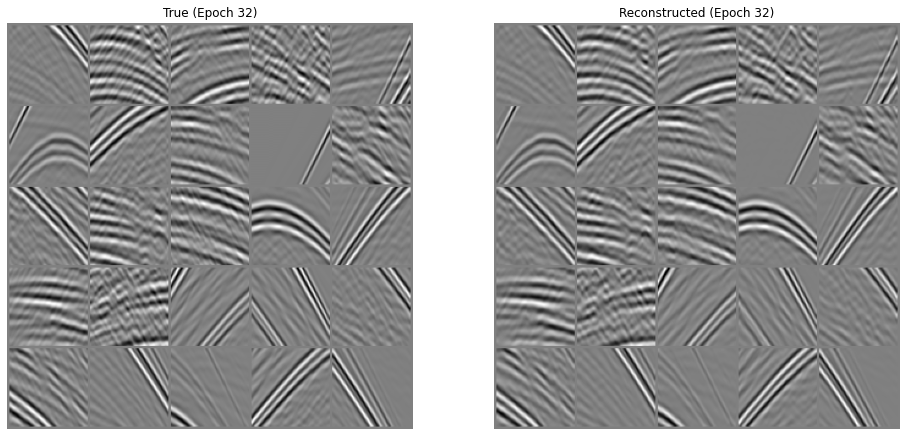

Validation: 0it [00:00, ?it/s]

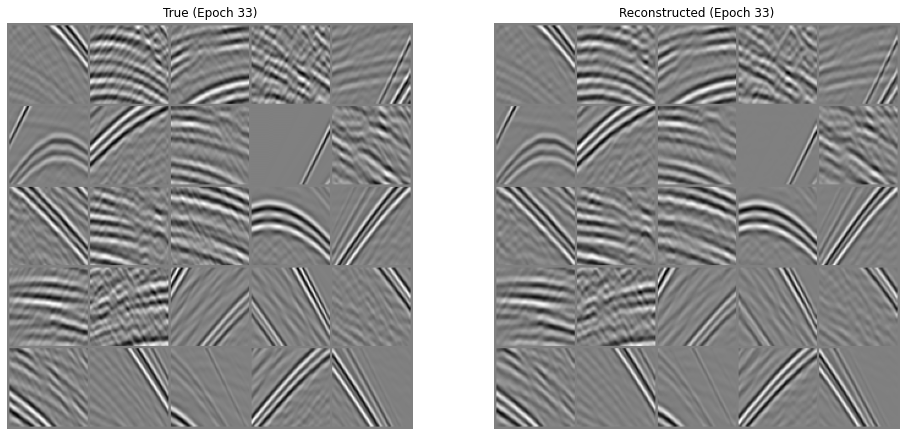

Validation: 0it [00:00, ?it/s]

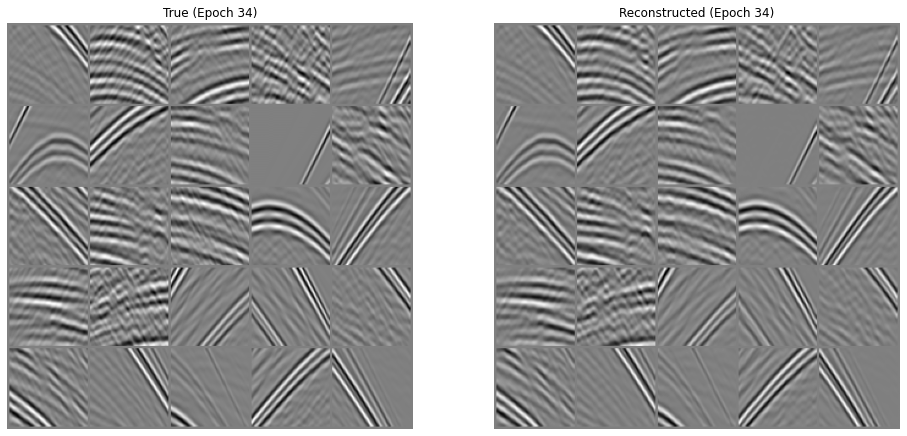

Validation: 0it [00:00, ?it/s]

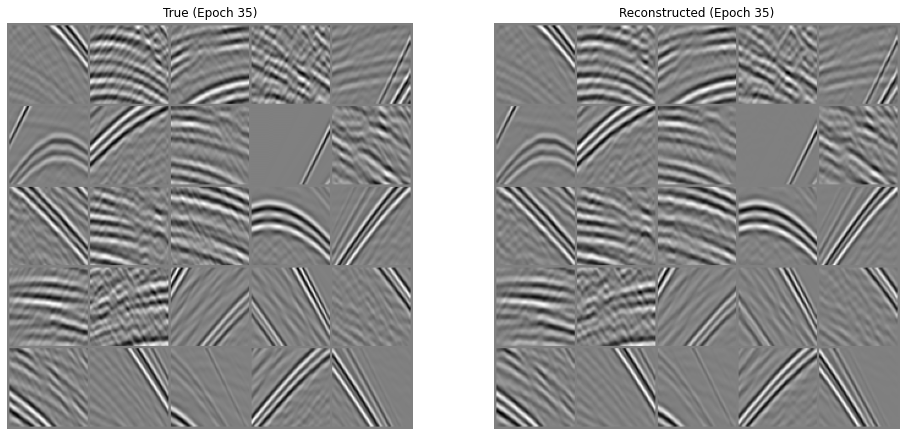

Validation: 0it [00:00, ?it/s]

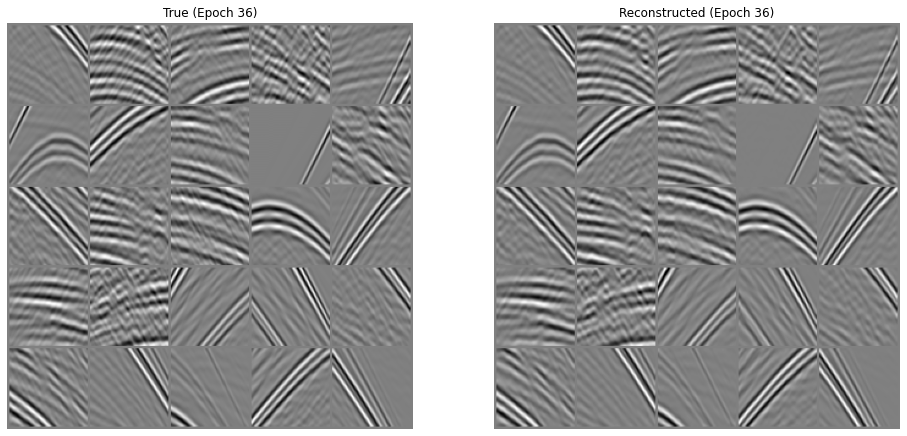

Validation: 0it [00:00, ?it/s]

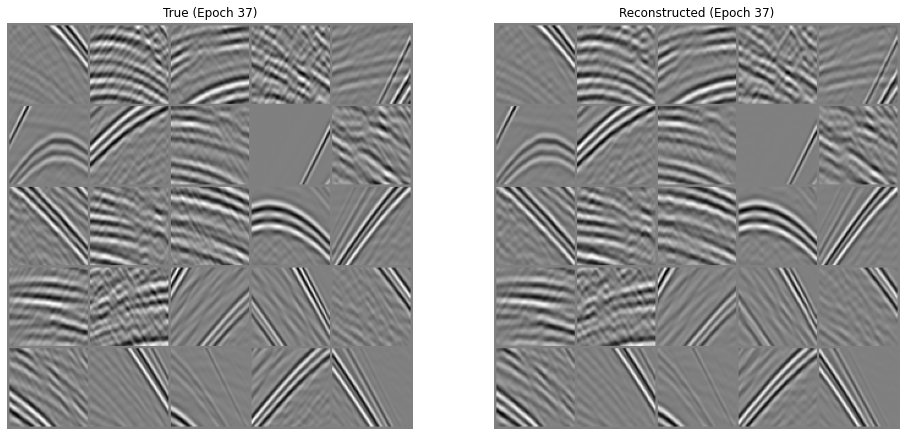

Validation: 0it [00:00, ?it/s]

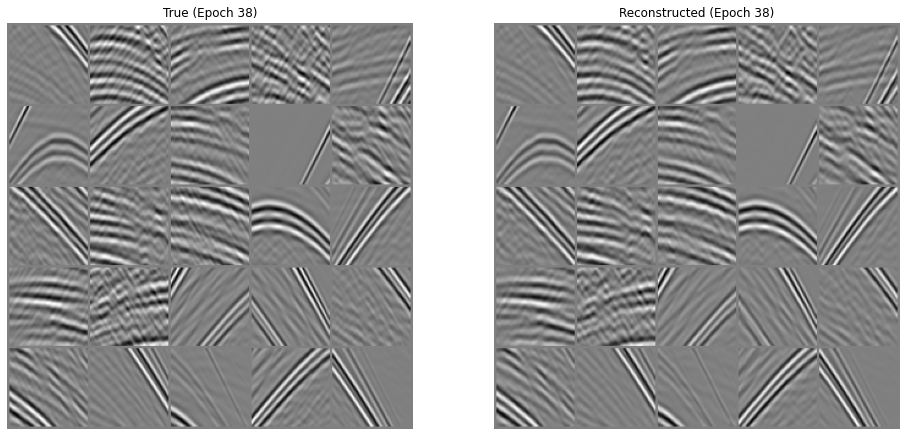

Validation: 0it [00:00, ?it/s]

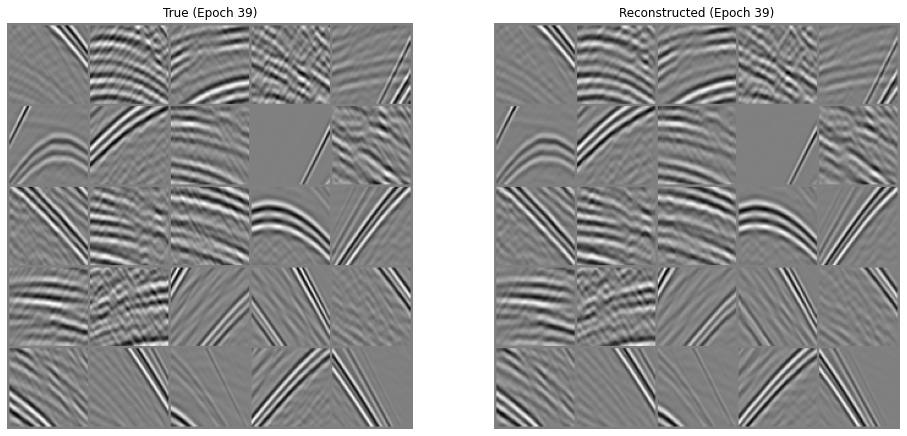

Validation: 0it [00:00, ?it/s]

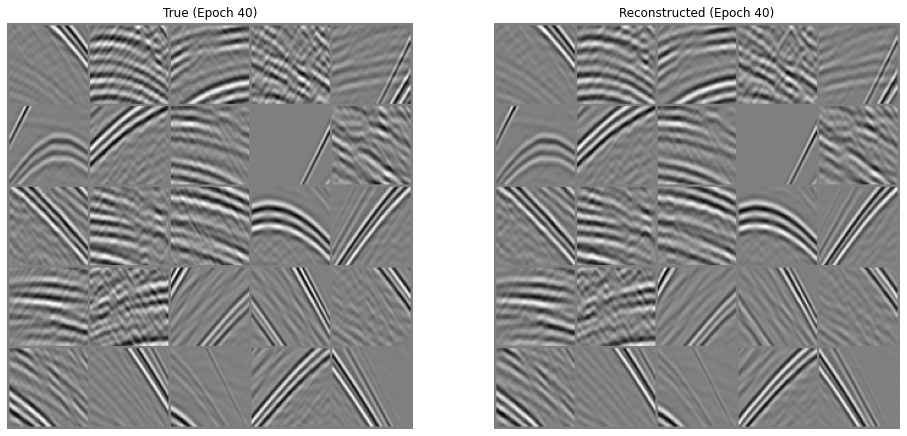

INFO: `Trainer.fit` stopped: `max_epochs=40` reached.


In [10]:
print('Working with Experiment %d - %s' % (iexp, expname))

# Create directory to save training evolution
figdir = os.path.join(outputfigs, 'exp%d' % iexp)

if figdir is not None:
    if not os.path.exists(figdir):
        os.mkdir(figdir)

# Create model to train
autoencoder = aetype(nh=nspatch, nw=ntpatch, nenc=nenc, 
                     kernel_size=kernel_size, nfilts=nfilts, 
                     nlayers=nlayers, nlevels=nlevels,
                     physics=B1op_torch, 
                     convbias=convbias, act_fun=act_fun, 
                     downstride=downstride, downmode=downmode,
                     upmode=upmode, bnormlast=bnormlast,  
                     relu_enc=relu_enc, tanh_enc=tanh_enc, 
                     relu_dec=relu_dec, tanh_final=tanh_final,
                     patcher=Pop1_torch, npatches=npatches[0]*npatches[1],
                     patchesscaling=scalings)

# Create dataset
datamodule = DataModule(xs, valid_size=0.1, random_state=42, batch_size=batch_size)

# Callbacks
early_stop_callback = pl_EarlyStopping(monitor="val_loss",
                                       mode="min",
                                       patience=es_patience,
                                       min_delta=es_min_delta)
callback = MetricsCallback(loss)
callback1 = PlottingCallback(figdir)

# Training
dimred = LitAutoencoder(nspatch, ntpatch, nenc,
                        autoencoder, loss, num_epochs, lossweights=lossweights,
                        learning_rate=learning_rate, weight_decay=weight_decay, betas=betas,
                        adapt_learning=True, lr_scheduler=lr_scheduler, lr_factor=lr_factor,
                        lr_thresh=lr_thresh, lr_patience=lr_patience, lr_max=lr_max,
                        noise_std=noise_std, mask_perc=mask_perc, device=device)

trainer = pl.Trainer(accelerator='gpu', devices=[devicenum, ],
                     max_epochs=dimred.num_epochs, log_every_n_steps=4, 
                     callbacks=[early_stop_callback, callback, callback1])
trainer.fit(dimred, datamodule)

# Save model
torch.save(autoencoder.state_dict(), os.path.join(outputmodels, 'exp%d_modelweights.pt' % iexp))

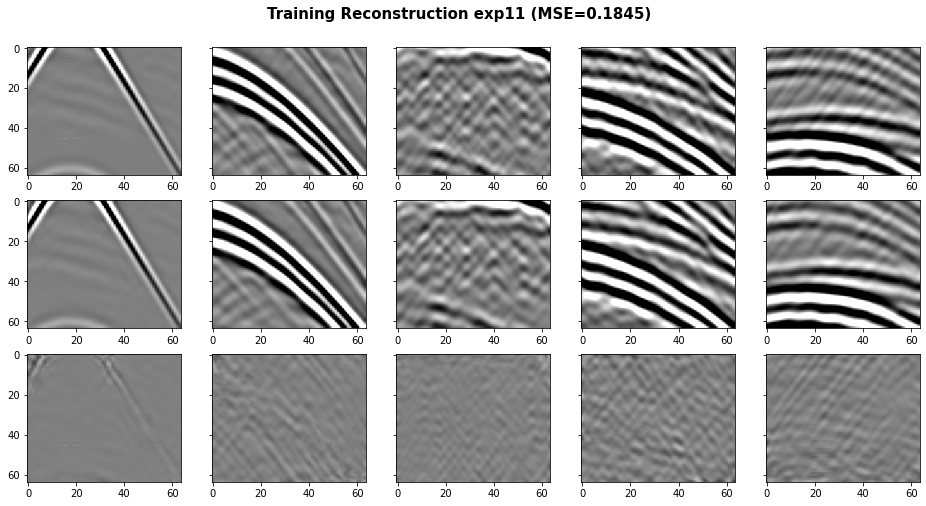

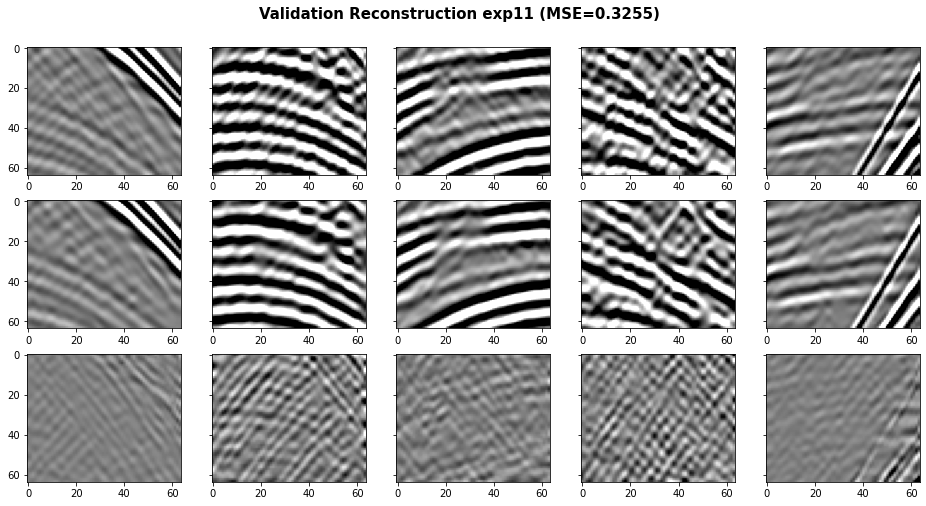

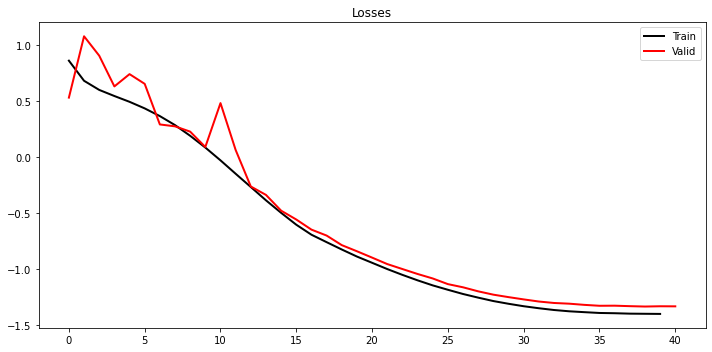

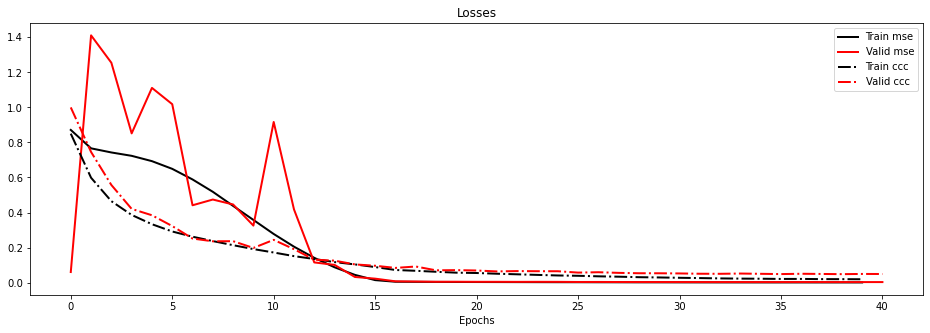

In [11]:
# Predict by manually piping encoder and decoder and visualize
nstats = 100
nviz = 5
cmax = 0.3

autoencoder.cuda(devicenum)
autoencoder.eval()
x_train = datamodule.x_train
x_valid = datamodule.x_valid

x_train_latent = torch.from_numpy(x_train[:nstats].astype(np.float32)).view(nstats, 1, nspatch, ntpatch).to(device)
latent = autoencoder.encode(x_train_latent)
x_train_ae = autoencoder.decode(latent)
x_train_mse = np.linalg.norm(x_train[:nstats].ravel() - x_train_ae[:nstats].detach().cpu().numpy().ravel()) / nstats
fig, axs = plt.subplots(3, nviz, sharey=True, figsize=(16, 8))
plt.suptitle(f'Training Reconstruction exp{iexp} (MSE={x_train_mse:.4f})',
             y=0.95, fontsize=15, fontweight='bold')
for i in range(nviz):
    # display original
    axs[0, i].imshow(x_train[i].reshape(nspatch, ntpatch).T, cmap='gray', 
                     vmin=-cmax, vmax=cmax)
    axs[0, i].axis('tight')
    # display reconstruction
    axs[1, i].imshow(x_train_ae[i].cpu().detach().numpy().reshape(nspatch, ntpatch).T, cmap='gray', 
                     vmin=-cmax, vmax=cmax)
    axs[1, i].axis('tight')
    # display error
    axs[2, i].imshow(x_train[i].reshape(nspatch, ntpatch).T - 
                     x_train_ae[i].cpu().detach().numpy().reshape(nspatch, ntpatch).T, cmap='gray', 
                     vmin=-cmax, vmax=cmax)
    axs[2, i].axis('tight')
plt.savefig(os.path.join(figdir, 'exp%d_train.png' % iexp))


x_valid_latent = torch.from_numpy(x_valid[:nstats].astype(np.float32)).view(nstats, 1, nspatch, ntpatch).to(device)
latent1 = autoencoder.encode(x_valid_latent)
x_valid_ae = autoencoder.decode(latent1)
x_valid_mse = np.linalg.norm(x_valid[:nstats].ravel() - x_valid_ae[:nstats].detach().cpu().numpy().ravel()) / nstats

fig, axs = plt.subplots(3, nviz, sharey=True, figsize=(16, 8))
plt.suptitle(f'Validation Reconstruction exp{iexp} (MSE={x_valid_mse:.4f})',
             y=0.95, fontsize=15, fontweight='bold')
for i in range(nviz):
    # display original
    axs[0, i].imshow(x_valid[i].reshape(nspatch, ntpatch).T, cmap='gray', 
                     vmin=-cmax, vmax=cmax)
    axs[0, i].axis('tight')
    # display reconstruction
    axs[1, i].imshow(x_valid_ae[i].cpu().detach().numpy().reshape(nspatch, ntpatch).T, cmap='gray', 
                     vmin=-cmax, vmax=cmax)
    axs[1, i].axis('tight')
    # display error
    axs[2, i].imshow(x_valid[i].reshape(nspatch, ntpatch).T - 
                     x_valid_ae[i].cpu().detach().numpy().reshape(nspatch, ntpatch).T, cmap='gray', 
                     vmin=-cmax, vmax=cmax)
    axs[2, i].axis('tight')
plt.savefig(os.path.join(figdir, 'exp%d_valid.png' % iexp))


# Display training losses
fig, ax = plt.subplots(1, 1, figsize=(10, 5))
ax.plot(callback.train_loss, 'k', lw=2, ms=10, label='Train')
ax.plot(callback.valid_loss, 'r', lw=2, ms=10, label='Valid')
ax.set_title('Losses')
ax.legend()
plt.tight_layout()
plt.savefig(os.path.join(figdir, 'exp%d_trainingvalidhistory.png' % iexp))

if isinstance(dimred.lossfunc, list):
    fig, ax = plt.subplots(1, 1 if lossweights is None else 2, figsize=(16, 5))
    ls = ['-', '-.', '--']
    for iloss, lossname in enumerate(dimred.losses_names):
        ax.plot(callback.train_losses[lossname], 'k', lw=2, ms=10, 
                linestyle=ls[iloss], label='Train %s' % lossname)
        ax.plot(callback.valid_losses[lossname], 'r', lw=2, ms=10,
                linestyle=ls[iloss], label='Valid %s' % lossname)
        ax.set_title('Losses')
    ax.legend()
    ax.set_xlabel('Epochs')

## Deblending

In [12]:
print('Deblending...')
autoencoder.train()
autoencoder.eval()

# Initial guess
patchesmask = Pop.H * ppseudo1.ravel()
patchesmask = patchesmask.reshape(npatches[0]*npatches[1], 1, nspatch, ntpatch)
patchesmask_scaled = patchesmask / scalings.cpu().detach().numpy()
p0 = autoencoder.encode(torch.from_numpy(patchesmask_scaled.astype(np.float32)).to(device)).cpu().detach().numpy()

# Invert
inv = InvertAll(device, # device
                nenc, npatches[0] * npatches[1],
                autoencoder, autoencoder.patched_physics_decode, autoencoder.patched_decode, # modelling ops
                nn.MSELoss(), 1., 80, # optimizer
                reg_ae=0., x0=p0, bounds=None
                )
minv, pinv = inv.scipy_invert(pblend_torch, torch.zeros(((ns, nt))).to(device))

# Recompute data from minv
if 'cuda' in str(device):
    dinv = cp.asnumpy(B1op * cp.asarray(minv))
else:
    dinv = Dupop * minv

minv = minv.reshape(ns, nt)
dinv = dinv.reshape(Bop.nttot)

Deblending...


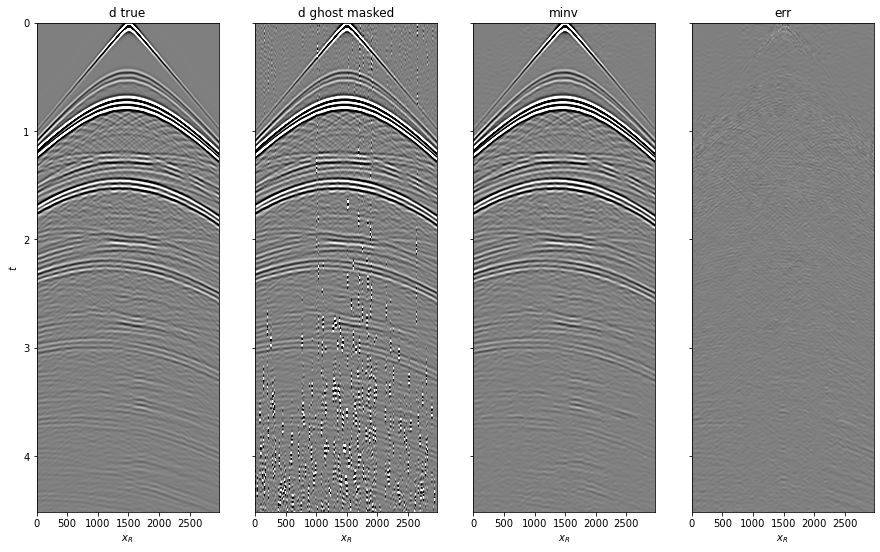

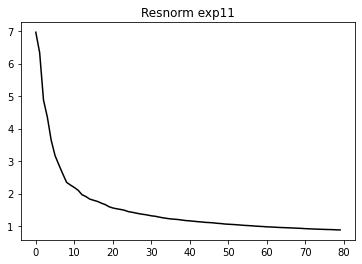

In [21]:
# Visualize
cmax = .05
tgain = np.ones_like(t)# np.exp(0.5*t)

fig, axs = plt.subplots(1, 4, sharey=True, figsize=(15, 9))
axs[0].imshow(p[:, irec].T * tgain[:, np.newaxis], cmap='gray', vmin=-cmax, vmax=cmax,
              extent=(s[0,0], s[0,-1], t[-1], t[0]))
axs[0].set_title('d true')
axs[0].set_xlabel(r'$x_R$')
axs[0].set_ylabel(r'$t$')
axs[0].axis('tight')
axs[1].imshow(ppseudo1.T * tgain[:, np.newaxis], cmap='gray', vmin=-cmax, vmax=cmax,
              extent=(s[0,0], s[0,-1], t[-1], t[0]))
axs[1].set_title('d ghost masked')
axs[1].set_xlabel(r'$x_R$')
axs[1].axis('tight')
axs[2].imshow(minv.T * tgain[:, np.newaxis], cmap='gray', vmin=-cmax, vmax=cmax,
              extent=(s[0,0], s[0,-1], t[-1], t[0]))
axs[2].set_title('minv')
axs[2].set_xlabel(r'$x_R$')
axs[2].axis('tight')
axs[3].imshow(p[:, irec].T * tgain[:, np.newaxis] - minv.T * tgain[:, np.newaxis], 
              cmap='gray', vmin=-cmax, vmax=cmax,
              extent=(s[0,0], s[0,-1], t[-1], t[0]))
axs[3].set_title('err')
axs[3].set_xlabel(r'$x_R$')
axs[3].axis('tight')

plt.figure()
plt.plot(inv.resnorm, 'k')
plt.title(f'Resnorm exp{iexp}');

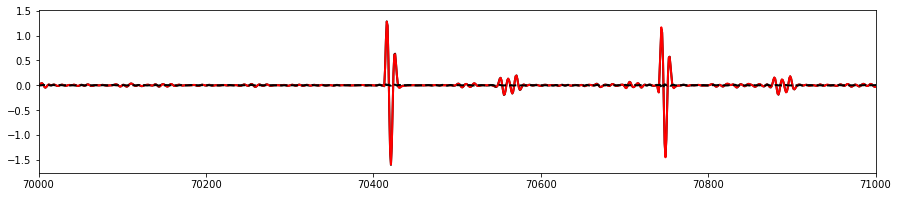

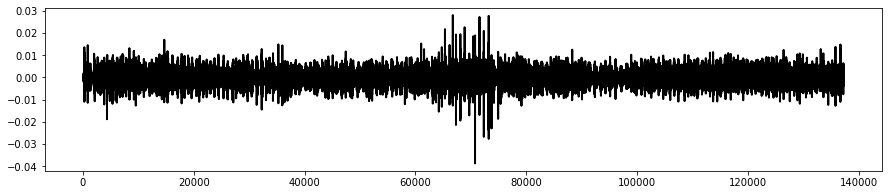

In [39]:
plt.figure(figsize=(15, 3))
plt.plot(pblend, 'k', lw=2)
plt.plot(dinv, 'r', lw=2)
plt.plot(pblend-dinv, '--k', lw=2)
plt.xlim(70000, 71000)

plt.figure(figsize=(15, 3))
plt.plot(pblend-dinv, 'k', lw=2)